# Field transect plots

In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

/explore/nobackup/people/pmontesa/.nccstmp/ipykernel_3105000/1580747635.py:1: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https://shapely.readthedocs.io/en/latest/migration_pygeos.html).
  import geopandas as gpd


In [2]:
from scipy.spatial import cKDTree

In [158]:
atl08_30m_gdf_roads = gpd.read_file('/explore/nobackup/people/pmontesa/userfs02/projects/ilab/above_shrubs/data/arc/atl08_seward_2km_roads.gpkg')
atl08_30m_gdf_roads.explore()

In [3]:
all_ref_gdf_extract = gpd.read_file('/explore/nobackup/people/pmontesa/userfs02/projects/ilab/above_shrubs/data/field/sewardpen2024/sewardpen2024_all_rs_validation_unmelted.gpkg')

/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/pyproj/../../.././libtiff.so.6: version `LIBTIFF_4.6.1' not found (required by /app/jupyter/ilab/jupyter-lab/prod/lib/gdalplugins/../libgdal.so.36)
/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/pyproj/../../.././libtiff.so.6: version `LIBTIFF_4.6.1' not found (required by /app/jupyter/ilab/jupyter-lab/prod/lib/gdalplugins/../libgdal.so.36)
/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/pyproj/../../.././libtiff.so.6: version `LIBTIFF_4.6.1' not found (required by /app/jupyter/ilab/jupyter-lab/prod/lib/gdalplugins/../libgdal.so.36)
/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/pyproj/../../.././libtiff.so.6: version `LIBTIFF_4.6.1' not found (required by /app/jupyter/ilab/jupyter-lab/prod/lib/gdalplugins/../libgdal.so.36)
/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3

### Field x, y are NaN so get them from geometry field

In [4]:
import pyproj

all_ref_gdf_extract['x'] , all_ref_gdf_extract['y'] = pyproj.transform(pyproj.Proj(init='epsg:4326'), pyproj.Proj(init='epsg:6933'), all_ref_gdf_extract.geometry.x, all_ref_gdf_extract.geometry.y)
#tmp_x , tmp_y = pyproj.transform(pyproj.Proj(init='epsg:4326'), pyproj.Proj(init='epsg:6933'), all_ref_gdf_extract.head().geometry.x, all_ref_gdf_extract.head().geometry.y)

/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/explore/nobackup/people/pmontesa/.nccstmp/ipykernel_3105000/1322140613.py:3: DeprecationWarning: This function is deprecated. See: http

In [5]:
import plotlib # sites adjacent to notebook

In [6]:
footprint_uav_gdf = gpd.read_file('/explore/nobackup/people/pmontesa/userfs02/projects/ilab/above_shrubs/data/field/sewardpen2024/footprints_uav_sewardpen2024_RGB_COG.gpkg').drop('date', axis=1)

In [7]:
# for site in ['kougarok_05']:
#     print(site)
#     # Remove rows where dsm values are NA
#     #atl03_TMP = atl03_field_gdf[atl03_field_gdf.dsm_uav != -10000]
#     plotlib.plot_atl03_transect(start=0, transect_length=50000, DO_HEIGHT=True, 
#                                 atl03_gdf=all_ref_gdf_extract[(all_ref_gdf_extract.type_ref == 'ATL03')&(all_ref_gdf_extract.site == site) &(all_ref_gdf_extract.dsm_uav != -10000)],
#                                 atl08_100m_gdf=None, #all_ref_gdf_extract[(all_ref_gdf_extract.type_ref == 'field 2m')&(all_ref_gdf_extract.site == site) &(all_ref_gdf_extract.dsm_uav != -10000)], #atl08_field_gdf_extract[(atl08_field_gdf_extract.site == site) ],#& (atl08_field_gdf_extract.dsm_uav != -10000)], 
#                                 # Fudging this - putting ref field pts in at atl08 30m slot
#                                 atl08_30m_gdf=all_ref_gdf_extract[
#                                     (all_ref_gdf_extract.type_ref == 'field 2m') & 
#                                     (all_ref_gdf_extract.site == site) & 
#                                     (all_ref_gdf_extract.dsm_uav != -10000)
#                                 ], #atl08_30m_field_gdf_extract[(atl08_30m_field_gdf_extract.site == site) ],#& (atl08_30m_field_gdf_extract.dsm_uav != -10000)], 
#                                 footprint_uav_gdf=footprint_uav_gdf[footprint_uav_gdf.site == site],
#                                site=site, PLOT_UAV=True, HEIGHT_COLS = ['ht_ifsar'], COL_ATL08_HT='height_ref',COL_ATL08_ELEV='elev', COL_ATL03_HT='height_ref', COL_UAV_HT='ht_uav')

In [175]:
# =============================================================================
# CONFIGURATION
# =============================================================================

PLOT_CONFIG = {
    'figsize_per_site': (10, 2),
    'dpi': 100,
    'height_ylim': (-0.25, 8),
    'alpha_atl03': 0.75,
    'alpha_field': 1.0,
    'alpha_models': 0.7,
    'verbose': False,
    'plot_atl03': True,     # NEW
    'plot_atl08_100m': True,     # NEW
    'plot_atl08_30m': True,     # NEW
    'plot_field': True,     # NEW
    'plot_models': True,    # NEW
}

ATL03_CLASSES = {
    0: {'name': 'Noise', 'color': 'lightgrey', 'size': 8, 'zorder': 1},
    1: {'name': 'Ground', 'color': 'brown', 'size': 10, 'zorder': 2},
    2: {'name': 'Canopy', 'color': 'lightgreen', 'size': 10, 'zorder': 3},
    3: {'name': 'Top of Canopy', 'color': 'darkgreen', 'size': 10, 'zorder': 4},
}

FIELD_STYLE = {
    'color': 'black',
    'marker': 'o',
    'size': 50,
    'edgecolor': 'black',
    'linewidth': 2,
    'alpha': 0.25,
    'zorder': 1,
    'label': 'Field Reference (2m)'
}

ATL08_STYLE = {
    '100m': {
        'color': 'orange',
        'marker': 'D',
        'size': 80,
        'alpha': 0.9,
        'edgecolor': 'darkorange',
        'linewidth': 1.5,
        'zorder': 8,
        'label': 'ATL08 100m'
    },
    '30m': {
        'color': 'none',
        'marker': 'o',
        'size': 60,
        'alpha': 1.0,
        'edgecolor': 'orange',
        'linewidth': 2,
        'zorder': 7,
        'label': 'ATL08 30m'
    }
}

MODEL_COLORS = ['#1b9e77', '#d95f02', '#7570b3', '#e7298a', '#66a61e', '#e6ab02', '#a6761d']
MODEL_COLORS = ['#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02','#a6761d','#666666']

MODEL_TYPES = {
    'airborne': {
        'marker': 'v',
        'size': 35,
        'patterns': ['uavchm', 'ifsar']
    },
    'spaceborne vhr': {
        'marker': '^',
        'size': 35,
        'patterns': ['chm_', 'nasa_cnn']
    },
    'spaceborne coarse': {
        'marker': 's',
        'size': 40,
        'patterns': ['HLS', 'lang', 'tolan', 'potapov']
    }
}

### ToDo: 
+ some "sites" have multiple transects assocaited with different ICESat-2 tracks - fix code to account for this
+ check if all measurements are all aligned correctly on each ATL03 transect

In [176]:
# =============================================================================
# UTILITY FUNCTIONS
# =============================================================================

def get_model_type(col_name):
    """Determine model type (vhr or coarse) from column name."""
    for model_type, config in MODEL_TYPES.items():
        if any(pattern in col_name for pattern in config['patterns']):
            return model_type
    return 'spaceborne coarse'

def is_missing_value(val):
    """Check if a value should be treated as missing (NaN, None, 'n/a', etc.)."""
    if pd.isna(val):
        return True
    if isinstance(val, str) and val.lower() in ['n/a', 'na', 'nan', 'none', '']:
        return True
    return False

def calculate_distance_along_track(data, reference_point):
    """Calculate distance from reference point."""
    if len(data) == 0:
        return np.array([])
    x = data['x'].values
    y = data['y'].values
    x0, y0 = reference_point
    return np.sqrt((x - x0)**2 + (y - y0)**2)

# =============================================================================
# DATA PREPARATION
# =============================================================================

def prepare_transect_data(gdf, ref_type='field 2m', scale_vhr_by_10=True, verbose=False):
    """Prepare and separate data by type."""
    
    gdf = gdf.copy()
    
    # Scale VHR columns if needed
    if scale_vhr_by_10:
        vhr_cols_to_scale = [col for col in gdf.columns 
                            if col.startswith('ht_') and 'chm_' in col]
        if verbose:
            print(f"Scaling {len(vhr_cols_to_scale)} VHR columns by 0.1 (dm to m)")
        for col in vhr_cols_to_scale:
            gdf[col] = gdf[col] / 10.0
    
    # Separate data by type
    atl03_data = gdf[gdf['type_ref'].str.contains('ATL03', na=False)].copy()
    field_data = gdf[gdf['type_ref'].isin(['field 2m', 'field 0.3m'])].copy()
    atl08_data = gdf[gdf['type_ref'].str.contains('ATL08', na=False)].copy()
    
    # Further separate ATL08 by resolution
    atl08_100m_data = atl08_data[~atl08_data['type_ref'].str.contains('30', na=False)].copy() if len(atl08_data) > 0 else pd.DataFrame()
    atl08_30m_data = atl08_data[atl08_data['type_ref'].str.contains('30', na=False)].copy() if len(atl08_data) > 0 else pd.DataFrame()
    
    if verbose:
        print(f"\nData summary:")
        print(f"  ATL03 rows: {len(atl03_data)}")
        print(f"  Field rows: {len(field_data)}")
        print(f"  ATL08 100m rows: {len(atl08_100m_data)}")
        print(f"  ATL08 30m rows: {len(atl08_30m_data)}")
        
        # Show beam/doy status
        if len(field_data) > 0:
            print(f"  Field beam values: {field_data['beam'].unique()[:5]}")
            print(f"  Field doy values: {field_data['doy'].unique()[:5]}")
        if len(atl08_data) > 0:
            print(f"  ATL08 beam values: {atl08_data['beam'].unique()[:5]}")
            print(f"  ATL08 doy values: {atl08_data['doy'].unique()[:5]}")
    
    return {
        'atl03': atl03_data,
        'field': field_data,
        'atl08_100m': atl08_100m_data,
        'atl08_30m': atl08_30m_data,
        'all': gdf
    }

def get_height_columns(gdf, pattern='ht_', include_ifsar=False, include_uav=False):
    """Get all height model columns from dataframe."""
    exclude = set()
    if not include_ifsar:
        exclude.add('ht_ifsar')
    if not include_uav:
        exclude.update(['ht_uav', 'ht_uavchm030', 'ht_uavchm200'])
    
    height_cols = [col for col in gdf.columns 
                   if col.startswith(pattern) and col not in exclude]
    return height_cols

def create_model_labels(col_names):
    """Create readable labels from column names."""
    labels = []
    for col in col_names:
        if col == 'ht_ifsar':
            labels.append('IFSAR CHM')
        elif col == 'ht_uavchm030':
            labels.append('UAV CHM (0.3m)')
        elif col == 'ht_uavchm200':
            labels.append('UAV CHM (2m)')
        elif col == 'ht_uav':
            labels.append('UAV DSM-DTM')
        elif 'boreal' in col:
            if 'H30' in col:
                labels.append('Boreal HLS 30m')
            elif 'S1H30' in col:
                labels.append('Boreal S1+HLS 30m')
        elif 'tolan' in col:
            labels.append('Tolan et al.')
        elif 'lang' in col:
            labels.append('Lang et al.')
        elif 'potapov' in col:
            labels.append('Potapov et al.')
        elif 'nasa_cnn' in col:
            labels.append('NASA VHR CNN')
        elif 'chm_' in col:
            parts = col.split('_')
            if len(parts) >= 2 and parts[1].isdigit():
                date = parts[1][:8]
                year = date[:4]
                version = parts[-1] if '.' in parts[-1] else 'v1'
                labels.append(f'VHR {date} v{version}')
            else:
                labels.append(col.replace('ht_', '').replace('_', ' '))
        else:
            labels.append(col.replace('ht_', '').replace('_', ' '))
    return labels

def get_transect_combinations(gdf):
    """Get unique site/beam/doy combinations from ATL03 data."""
    
    atl03_data = gdf[gdf['type_ref'].str.contains('ATL03', na=False)]
    
    if len(atl03_data) == 0:
        return []
    
    # Build list of grouping columns that have real values (not all 'n/a')
    group_cols = ['site']
    
    if 'beam' in atl03_data.columns:
        real_beams = atl03_data[~atl03_data['beam'].apply(is_missing_value)]
        if len(real_beams) > 0:
            group_cols.append('beam')
    
    if 'doy' in atl03_data.columns:
        real_doys = atl03_data[~atl03_data['doy'].apply(is_missing_value)]
        if len(real_doys) > 0:
            group_cols.append('doy')
    
    # Get unique combinations
    combinations = atl03_data[group_cols].drop_duplicates().values.tolist()
    
    # Convert to tuples, padding with None
    transects = []
    for combo in combinations:
        if not isinstance(combo, (list, tuple)):
            combo = [combo]
        else:
            combo = list(combo)
        
        while len(combo) < 3:
            combo.append(None)
        
        transects.append(tuple(combo[:3]))  # (site, beam, doy)
    
    return sorted(transects)

# =============================================================================
# PLOTTING FUNCTIONS
# =============================================================================

def plot_site_transect(ax, site_data, height_cols, config=PLOT_CONFIG, 
                       site_name=None, beam=None, doy=None):
    """Plot transect for a single site/beam/doy combination."""
    
    atl03 = site_data['atl03']
    field = site_data['field']
    atl08_100m = site_data.get('atl08_100m', pd.DataFrame())
    atl08_30m = site_data.get('atl08_30m', pd.DataFrame())
    
    verbose = config.get('verbose', False)
    
    if verbose:
        print(f"    Plotting: ATL03={len(atl03)}, Field={len(field)}, "
              f"ATL08-100m={len(atl08_100m)}, ATL08-30m={len(atl08_30m)}")
    
    added_labels = set()
    
    # =========================================================================
    # PLOT ATL03 PHOTONS
    # =========================================================================
    if config.get('plot_atl03', True) and len(atl03) > 0:
        for class_val, class_info in ATL03_CLASSES.items():
            mask = atl03['class'] == class_val
            if mask.sum() > 0:
                label = f"{class_info['name']} (ATL03)" if class_info['name'] not in added_labels else None
                if label:
                    added_labels.add(class_info['name'])
                
                ax.scatter(
                    atl03.loc[mask, 'distance'],
                    atl03.loc[mask, 'height_ref'],
                    s=class_info['size'],
                    c=class_info['color'],
                    alpha=config['alpha_atl03'],
                    linewidth=0,
                    label=label,
                    zorder=class_info['zorder']
                )
    
    # =========================================================================
    # PLOT ATL08 100m
    # =========================================================================
    if config.get('plot_atl08_100m', True) and len(atl08_100m) > 0:
        style = ATL08_STYLE['100m']
        # Plot horizontal bars for each point
        for idx, row in atl08_100m.iterrows():
            ax.hlines(
                y=row['height_ref'],
                xmin=row['distance'] - 50,  # 50m to the left
                xmax=row['distance'] + 50,  # 50m to the right
                colors=style['edgecolor'],
                linewidth=2,
                alpha=style['alpha'] * 0.7,
                zorder=style['zorder'] - 1
            )
        
        # Plot center points
        ax.scatter(
            atl08_100m['distance'],
            atl08_100m['height_ref'],
            s=style['size'],
            c=style['color'],
            alpha=style['alpha'],
            marker=style['marker'],
            edgecolors=style['edgecolor'],
            linewidth=style['linewidth'],
            label=style['label'],
            zorder=style['zorder']
        )
    
    # =========================================================================
    # PLOT ATL08 30m
    # =========================================================================
    if config.get('plot_atl08_30m', True) and len(atl08_30m) > 0:
        style = ATL08_STYLE['30m']
        # Plot horizontal bars for each point
        for idx, row in atl08_30m.iterrows():
            ax.hlines(
                y=row['height_ref'],
                xmin=row['distance'] - 15,  # 15m to the left
                xmax=row['distance'] + 15,  # 15m to the right
                colors=style['edgecolor'],
                linewidth=2,
                alpha=style['alpha'],
                zorder=style['zorder'] - 1
            )
        
        # Plot center points
        ax.scatter(
            atl08_30m['distance'],
            atl08_30m['height_ref'],
            s=style['size'],
            facecolors=style['color'],
            alpha=style['alpha'],
            marker=style['marker'],
            edgecolors=style['edgecolor'],
            linewidth=style['linewidth'],
            label=style['label'],
            zorder=style['zorder']
        )
    
    # =========================================================================
    # PLOT HEIGHT MODEL PREDICTIONS
    # =========================================================================
    if len(field) > 0:
        labels = create_model_labels(height_cols)
        
        for i, col in enumerate(height_cols):
            if col in field.columns:
                mask = (field[col].notna()) & \
                       (field[col] != -9999) & \
                       (field[col] != 255) & \
                       (field[col] >= 0)
                
                if mask.sum() > 0:
                    color = MODEL_COLORS[i % len(MODEL_COLORS)]
                    label = labels[i]
                    
                    model_type = get_model_type(col)
                    marker = MODEL_TYPES[model_type]['marker']
                    size = MODEL_TYPES[model_type]['size']
                    
                    ax.scatter(
                        field.loc[mask, 'distance'],
                        field.loc[mask, col],
                        s=size,
                        c=color,
                        alpha=config['alpha_models'],
                        marker=marker,
                        linewidth=0,
                        label=label,
                        zorder=5
                    )
    
    # =========================================================================
    # PLOT FIELD REFERENCE
    # =========================================================================
    if len(field) > 0:
        mask = (field['height_ref'].notna()) & \
               (field['height_ref'] >= 0) & \
               (field['height_ref'] != -9999) & \
               (field['distance'].notna())
        
        if mask.sum() > 0:
            ax.scatter(
                field.loc[mask, 'distance'],
                field.loc[mask, 'height_ref'],
                s=FIELD_STYLE['size'],
                c=FIELD_STYLE['color'],
                alpha=FIELD_STYLE['alpha'],
                marker=FIELD_STYLE['marker'],
                edgecolors=FIELD_STYLE['edgecolor'],
                linewidth=FIELD_STYLE['linewidth'],
                label=FIELD_STYLE['label'],
                zorder=FIELD_STYLE['zorder']
            )
    
    # =========================================================================
    # FORMATTING
    # =========================================================================
    ax.set_xlabel('Distance along transect (m)', fontsize=11)
    ax.set_ylabel('Height (m)', fontsize=11)
    ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)

    # =========================================================================
    # ADD GROUND LINE AT Y=0 (ADD THIS SECTION HERE)
    # =========================================================================
    ax.axhline(y=0, color='black', linestyle='--', linewidth=1.5, 
               alpha=0.7, zorder=0, label='Ground (y=0)')
    # Alternative styles:
    # ax.axhline(y=0, color='gray', linestyle='--', linewidth=2, alpha=0.8)
    # ax.axhline(y=0, color='darkgreen', linestyle='-.', linewidth=1.5, alpha=0.6)
    
    if config['height_ylim'] is not None:
        ax.set_ylim(config['height_ylim'])
    
    # Set x-axis limits
    all_distances = []
    for data in [atl03, field, atl08_100m, atl08_30m]:
        if len(data) > 0 and 'distance' in data.columns:
            all_distances.extend(data['distance'].dropna().values)
    
    if len(all_distances) > 0:
        min_dist = min(all_distances)
        max_dist = max(all_distances)
        padding = (max_dist - min_dist) * 0.05 if max_dist > min_dist else 10
        ax.set_xlim(min_dist - padding, max_dist + padding)
    
    ax.legend(loc='upper right', fontsize=8, framealpha=0.9)

    # Diagnostic code to check ATL08 spacing
    atl08_30m_sorted = atl08_30m.sort_values('distance')
    spacings = np.diff(atl08_30m_sorted['distance'].values)
    
    print(f"ATL08 30m segment spacings (m):")
    print(f"  Min: {spacings.min():.1f}")
    print(f"  Max: {spacings.max():.1f}")
    print(f"  Mean: {spacings.mean():.1f}")
    print(f"  Median: {np.median(spacings):.1f}")

def create_faceted_transect_plot(
    gdf,
    ref_type='field 2m',
    height_cols=None,
    vhr_cols=None,
    transects=None,
    ncols=1,
    config=PLOT_CONFIG,
    title=None,
    scale_vhr_by_10=True
):
    """Create faceted transect plots by site/beam/doy combination."""
    
    # Handle backwards compatibility
    if vhr_cols is not None and height_cols is None:
        height_cols = vhr_cols
    
    verbose = config.get('verbose', False)
    
    # Prepare data
    data = prepare_transect_data(gdf, ref_type, scale_vhr_by_10, verbose)
    
    # Get transects to plot
    if transects is None:
        transects = get_transect_combinations(gdf)
        if len(transects) == 0:
            print("ERROR: No transects found!")
            return None, None
    
    if verbose:
        print(f"\nFound {len(transects)} transects:")
        for t in transects:
            print(f"  {t}")
    
    # Get height columns
    if height_cols is None:
        height_cols = get_height_columns(gdf)
    
    # Calculate grid dimensions
    n_transects = len(transects)
    nrows = int(np.ceil(n_transects / ncols))
    
    # Create figure
    figsize = (config['figsize_per_site'][0] * ncols, 
               config['figsize_per_site'][1] * nrows)
    fig, axes = plt.subplots(nrows, ncols, figsize=figsize, squeeze=False)
    axes = axes.flatten()
    
    # Plot each transect
    for idx, (site, beam, doy) in enumerate(transects):
        ax = axes[idx]
        
        if verbose:
            print(f"\n  Transect {idx+1}: site={site}, beam={beam}, doy={doy}")
        
        # =================================================================
        # FILTER DATA FOR THIS TRANSECT
        # =================================================================
        
        def build_mask(df, site, beam, doy):
            """
            Build filter mask. 
            For field/ATL08 data with 'n/a' in beam/doy, just use site.
            """
            mask = (df['site'] == site)
            
            # Only filter by beam/doy if they have real values
            if beam is not None and 'beam' in df.columns:
                # Check if this dataframe actually has real beam values
                has_real_beams = ~df['beam'].apply(is_missing_value).all()
                if has_real_beams:
                    mask &= (df['beam'] == beam)
            
            if doy is not None and 'doy' in df.columns:
                # Check if this dataframe actually has real doy values
                has_real_doys = ~df['doy'].apply(is_missing_value).all()
                if has_real_doys:
                    mask &= (df['doy'] == doy)
            
            return mask
        
        # Filter each data type
        transect_atl03 = data['atl03'][build_mask(data['atl03'], site, beam, doy)].copy()
        transect_field = data['field'][build_mask(data['field'], site, beam, doy)].copy()
        transect_atl08_100m = data['atl08_100m'][build_mask(data['atl08_100m'], site, beam, doy)].copy()
        transect_atl08_30m = data['atl08_30m'][build_mask(data['atl08_30m'], site, beam, doy)].copy()
        
        if verbose:
            print(f"    After filtering: ATL03={len(transect_atl03)}, Field={len(transect_field)}, "
                  f"ATL08-100m={len(transect_atl08_100m)}, ATL08-30m={len(transect_atl08_30m)}")
        
        if len(transect_atl03) == 0:
            ax.text(0.5, 0.5, 'No ATL03 data', ha='center', va='center', 
                   transform=ax.transAxes, fontsize=12)
            title_parts = [f'Site: {site}']
            if beam:
                title_parts.append(f'Beam: {beam.upper()}')
            if doy:
                title_parts.append(f'DOY: {doy}')
            ax.set_title(' | '.join(title_parts), fontsize=12, fontweight='bold')
            continue
        
        # =================================================================
        # CALCULATE DISTANCE FROM FIRST ATL03 POINT
        # =================================================================
        
        transect_atl03 = transect_atl03.sort_values('x')
        reference_point = (transect_atl03['x'].iloc[0], transect_atl03['y'].iloc[0])
        
        transect_atl03['distance'] = calculate_distance_along_track(transect_atl03, reference_point)
        
        if len(transect_field) > 0:
            transect_field['distance'] = calculate_distance_along_track(transect_field, reference_point)
        
        if len(transect_atl08_100m) > 0:
            transect_atl08_100m['distance'] = calculate_distance_along_track(transect_atl08_100m, reference_point)
        
        if len(transect_atl08_30m) > 0:
            transect_atl08_30m['distance'] = calculate_distance_along_track(transect_atl08_30m, reference_point)
        
        # =================================================================
        # PLOT
        # =================================================================
        
        transect_data = {
            'atl03': transect_atl03,
            'field': transect_field,
            'atl08_100m': transect_atl08_100m,
            'atl08_30m': transect_atl08_30m
        }
        
        plot_site_transect(ax, transect_data, height_cols, config, 
                          site_name=site, beam=beam, doy=doy)
        
        # Title
        title_parts = [f'Site: {site}']
        if beam:
            title_parts.append(f'Beam: {beam.upper()}')
        if doy:
            title_parts.append(f'DOY: {doy}')
        
        ax.set_title(' | '.join(title_parts), fontsize=12, fontweight='bold', pad=10)
    
    # Hide unused subplots
    for idx in range(n_transects, len(axes)):
        axes[idx].set_visible(False)
    
    if title:
        fig.suptitle(title, fontsize=16, fontweight='bold', y=0.995)
    
    plt.tight_layout()
    
    return fig, axes

In [177]:
# Quick diagnostic
field_data = all_ref_gdf_extract[all_ref_gdf_extract['type_ref'] == 'field 2m']
print("Field data has beam?", 'beam' in field_data.columns and field_data['beam'].notna().any())
print("Field data has doy?", 'doy' in field_data.columns and field_data['doy'].notna().any())
print("Unique beams in field:", field_data['beam'].unique() if 'beam' in field_data.columns else 'N/A')
print("Unique doys in field:", field_data['doy'].unique() if 'doy' in field_data.columns else 'N/A')

atl08_30m_data = all_ref_gdf_extract[all_ref_gdf_extract['type_ref'].str.contains('30', na=False)]
if len(atl08_30m_data) > 0:
    print("\nATL08 30m_data data has beam?", 'beam' in atl08_30m_data.columns and atl08_30m_data['beam'].notna().any())
    print("ATL08 30m data has doy?", 'doy' in atl08_30m_data.columns and atl08_30m_data['doy'].notna().any())

Field data has beam? True
Field data has doy? True
Unique beams in field: ['n/a']
Unique doys in field: ['n/a']

ATL08 30m_data data has beam? True
ATL08 30m data has doy? True


In [178]:
all_ref_gdf_extract.filter(like="uav").columns
all_ref_gdf_extract.filter(like="nasa_cnn").columns

Index(['ht_nasa_cnn_10m'], dtype='object')

In [179]:
# Example with selected models
height_cols_AIR_VHR = [
        'ht_ifsar',
    'ht_uavchm200',
    'ht_20110727_103001000D914900chm_4.3.2.2',
       'ht_20120721_103001001AB23900chm_4.3.2.2',
       'ht_20160817_103001005B484100chm_4.3.2.2',
       'ht_20190820_10300100954DE000chm_4.3.2.2',
       'ht_20190820_10300100968FB300chm_4.3.2.2',
       'ht_20190820_1030010099BF2F00chm_4.3.2.2',
       'ht_20200722_10300100AB1FD100chm_4.3.2.2',
       'ht_20170719_104001002F7A2E00chm_4.3.2.2',
       'ht_20190822_104001005054F700chm_4.3.2.2',
       'ht_20200704_104001005EADB900chm_4.3.2.2',
    'ht_nasa_cnn_10m',
]
height_cols_MOST = [
    'ht_ifsar',
    'ht_uavchm200',
    'ht_20110727_103001000D914900chm_4.3.2.2',
       'ht_20120721_103001001AB23900chm_4.3.2.2',
       'ht_20160817_103001005B484100chm_4.3.2.2',
       'ht_20190820_10300100954DE000chm_4.3.2.2',
       'ht_20190820_10300100968FB300chm_4.3.2.2',
       'ht_20190820_1030010099BF2F00chm_4.3.2.2',
       'ht_20200722_10300100AB1FD100chm_4.3.2.2',
       'ht_20170719_104001002F7A2E00chm_4.3.2.2',
       'ht_20190822_104001005054F700chm_4.3.2.2',
       'ht_20200704_104001005EADB900chm_4.3.2.2',
    'ht_nasa_cnn_10m',
    'ht_lang','ht_tolan',
    'ht_boreal_H30_2020', 'ht_boreal_S1H30_2020'
    #,'ht_potapov'
]

In [180]:
PLOT_CONFIG

{'figsize_per_site': (10, 2),
 'dpi': 100,
 'height_ylim': (-0.25, 8),
 'alpha_atl03': 0.75,
 'alpha_field': 1.0,
 'alpha_models': 0.7,
 'verbose': False,
 'plot_atl03': True,
 'plot_atl08_100m': True,
 'plot_atl08_30m': True,
 'plot_field': True,
 'plot_models': True}

In [194]:
config_no_icesat = PLOT_CONFIG.copy()
config_no_icesat['figsize_per_site'] = (8,4)
config_no_icesat['plot_atl03'] = False
config_no_icesat['plot_atl08_100m'] = False
config_no_icesat['plot_atl08_30m'] = False

ATL08 30m segment spacings (m):
  Min: 11.2
  Max: 21.1
  Mean: 16.2
  Median: 16.3


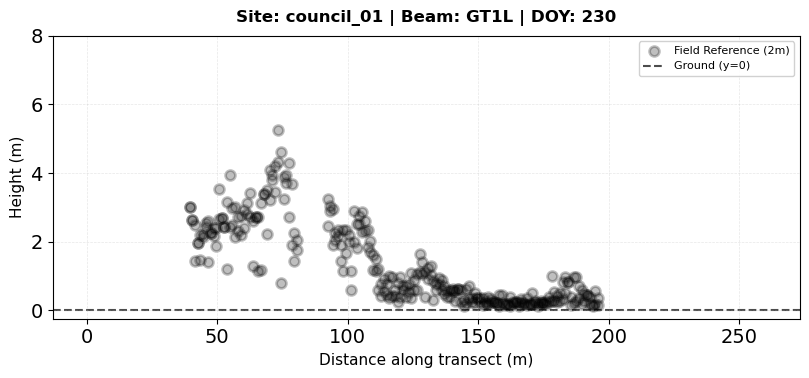

ATL08 30m segment spacings (m):
  Min: 11.2
  Max: 21.1
  Mean: 16.2
  Median: 16.3


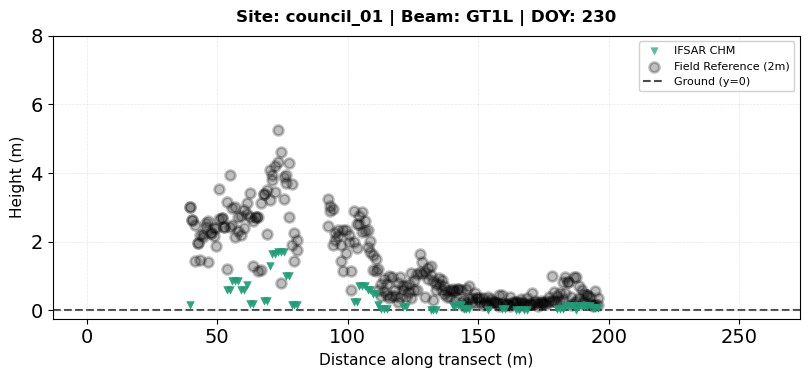

ATL08 30m segment spacings (m):
  Min: 11.2
  Max: 21.1
  Mean: 16.2
  Median: 16.3


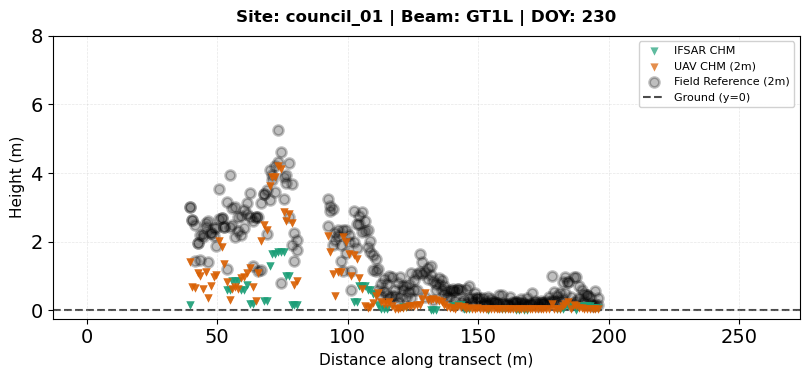

ATL08 30m segment spacings (m):
  Min: 11.2
  Max: 21.1
  Mean: 16.2
  Median: 16.3


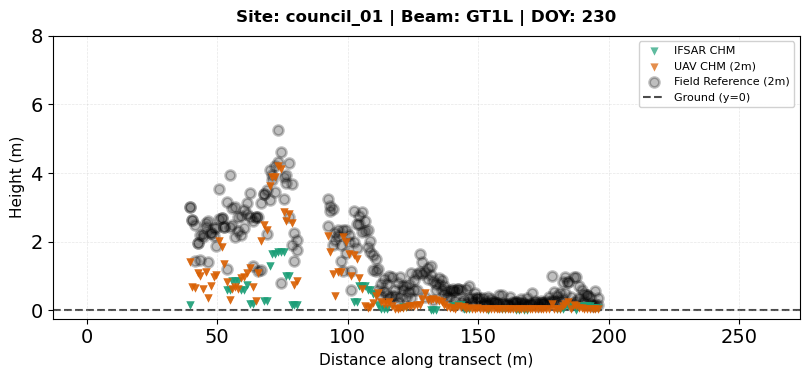

ATL08 30m segment spacings (m):
  Min: 11.2
  Max: 21.1
  Mean: 16.2
  Median: 16.3


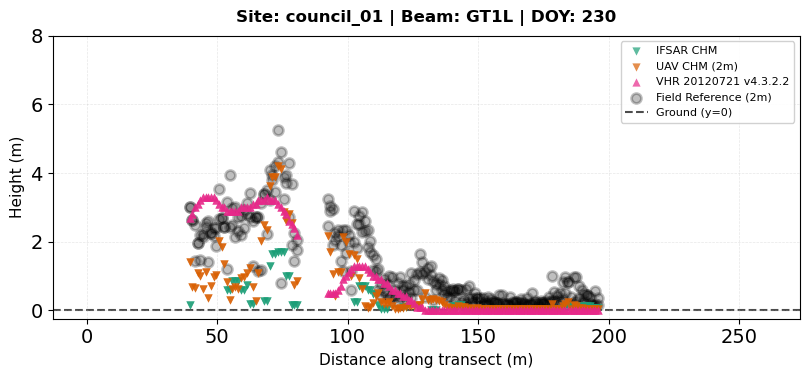

ATL08 30m segment spacings (m):
  Min: 11.2
  Max: 21.1
  Mean: 16.2
  Median: 16.3


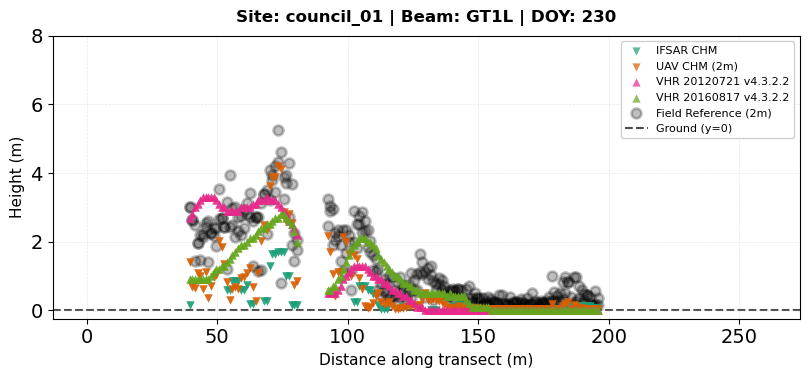

In [195]:
# Show 1 site
for i, col in enumerate(height_cols_selected):
    start_col = 0
    end_col = 0 + i
    fig, axes = create_faceted_transect_plot(
        gdf=all_ref_gdf_extract[all_ref_gdf_extract.site == 'council_01'],
        height_cols=height_cols_MOST[start_col:end_col],
        ref_type='field 2m',
        ncols=2,
        config=config_no_icesat
    )
    if fig:
        plt.show()

In [152]:
all_ref_gdf_extract.loc[all_ref_gdf_extract.type_ref == 'ATL08 30m' , ~all_ref_gdf_extract.columns.str.contains('ht_')].explore()

In [183]:
PLOT_CONFIG

{'figsize_per_site': (10, 2),
 'dpi': 100,
 'height_ylim': (-0.25, 8),
 'alpha_atl03': 0.75,
 'alpha_field': 1.0,
 'alpha_models': 0.7,
 'verbose': False,
 'plot_atl03': True,
 'plot_atl08_100m': True,
 'plot_atl08_30m': True,
 'plot_field': True,
 'plot_models': True}

Scaling 129 VHR columns by 0.1 (dm to m)

Data summary:
  ATL03 rows: 8215
  Field rows: 2280
  ATL08 100m rows: 49
  ATL08 30m rows: 116
  Field beam values: ['n/a']
  Field doy values: ['n/a']
  ATL08 beam values: ['n/a']
  ATL08 doy values: ['n/a']

Found 12 transects:
  ('council_01', 'gt1l', '230')
  ('council_02', 'gt2l', '216')
  ('council_02', 'gt2r', '212')
  ('kougarok_01', 'gt3l', '172')
  ('kougarok_02', 'gt1l', '199')
  ('kougarok_02', 'gt1l', '205')
  ('kougarok_03', 'gt3l', '193')
  ('kougarok_04', 'gt2l', '193')
  ('kougarok_05', 'gt2l', '193')
  ('kougarok_06', 'gt2l', '172')
  ('teller_01', 'gt1l', '166')
  ('teller_01', 'gt1l', '251')

  Transect 1: site=council_01, beam=gt1l, doy=230
    After filtering: ATL03=633, Field=280, ATL08-100m=5, ATL08-30m=17
    Plotting: ATL03=633, Field=280, ATL08-100m=5, ATL08-30m=17
ATL08 30m segment spacings (m):
  Min: 11.2
  Max: 21.1
  Mean: 16.2
  Median: 16.3

  Transect 2: site=council_02, beam=gt2l, doy=216
    After filtering

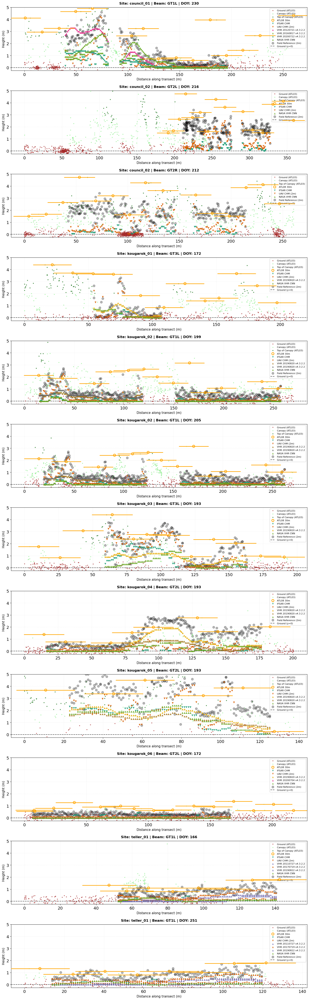

In [186]:
config = PLOT_CONFIG.copy()
config['figsize_per_site'] = (15,4)
config['height_ylim'] = (-0.25, 5)
config['plot_atl08_100m'] = False
config['verbose'] = True
fig, axes = create_faceted_transect_plot(
    gdf=all_ref_gdf_extract,
    height_cols=height_cols_AIR_VHR,
    ncols=1,
    config=config
)
if fig:
    plt.show()

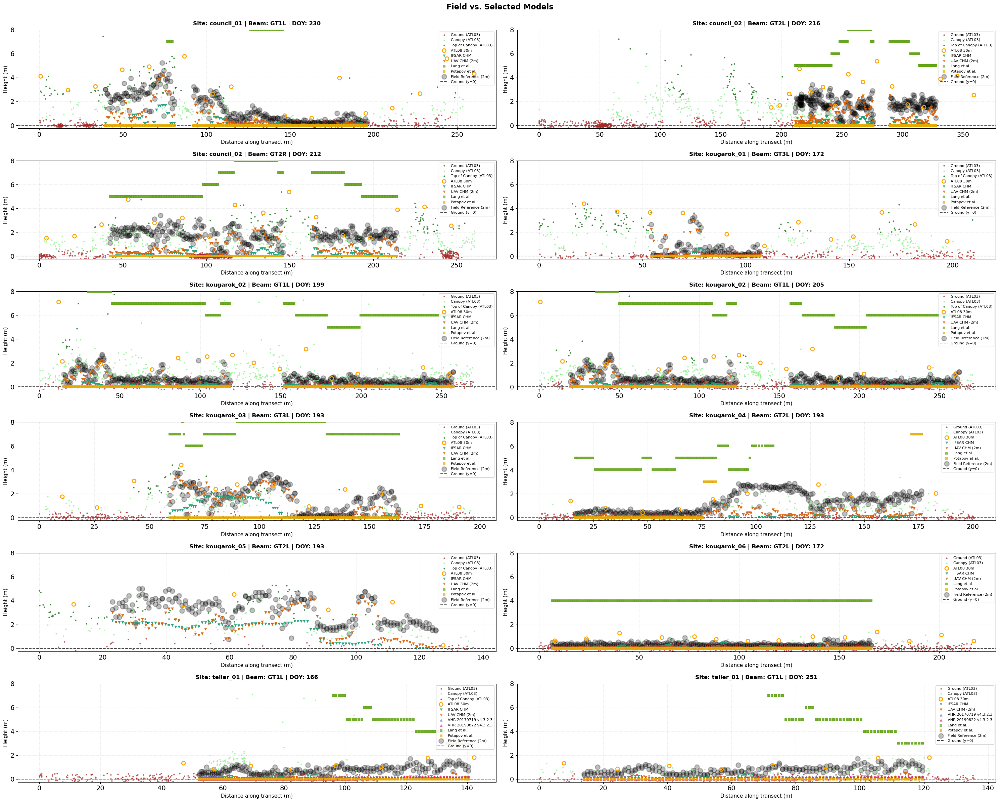

In [102]:
# Example 2: Selected models with custom buffer
height_cols_selected = [
    'ht_ifsar',
    'ht_uavchm200',
    'ht_20170719_104001002F7A2E00chm_4.3.2.3',
    'ht_20190822_104001005054F700chm_4.3.2.3',
    'ht_lang',
    'ht_potapov'
]

config_custom = PLOT_CONFIG.copy()
config_custom['field_buffer_m'] = 100  # Increase buffer to 100m

fig, axes = create_faceted_transect_plot(
    gdf=all_ref_gdf_extract,
    ref_type='field 2m',
    height_cols=height_cols_selected,
    ncols=2,
    config=config_custom,
    title='Field vs. Selected Models'
)
if fig:
    plt.show()

/explore/nobackup/people/pmontesa/.nccstmp/ipykernel_3105000/1376479776.py:477: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()


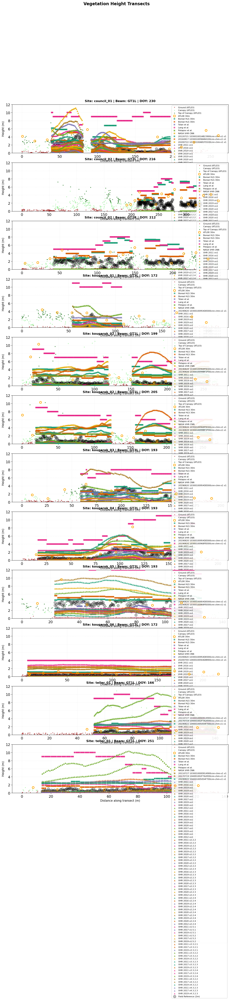

In [17]:
# Example 1: Basic plot with auto-detection
fig, axes = create_faceted_transect_plot(
    gdf=all_ref_gdf_extract,
    ref_type='field 2m',
    ncols=1,
    title='Vegetation Height Transects'
)
if fig:
    plt.show()

In [79]:
all_ref_gdf_extract.filter(like="chm_4.3.2.2").columns

Index(['ht_20110727_103001000D914900chm_4.3.2.2',
       'ht_20120721_103001001AB23900chm_4.3.2.2',
       'ht_20160817_103001005B484100chm_4.3.2.2',
       'ht_20190820_10300100954DE000chm_4.3.2.2',
       'ht_20190820_10300100968FB300chm_4.3.2.2',
       'ht_20190820_1030010099BF2F00chm_4.3.2.2',
       'ht_20200722_10300100AB1FD100chm_4.3.2.2',
       'ht_20170719_104001002F7A2E00chm_4.3.2.2',
       'ht_20190822_104001005054F700chm_4.3.2.2',
       'ht_20200704_104001005EADB900chm_4.3.2.2'],
      dtype='object')

In [83]:
all_ref_gdf_extract.head()

,type_ref,class,site,beam,doy,x,y,elev,height_ref,class_name,...,ht_20190820_10300100954DE000chm_4.3.2.3,ht_20190820_10300100968FB300chm_4.3.2.3,ht_20190820_1030010099BF2F00chm_4.3.2.3,ht_20200722_10300100AB1FD100chm_4.3.2.3,ht_20170719_104001002F7A2E00chm_4.3.2.3,ht_20190822_104001005054F700chm_4.3.2.3,ht_20200704_104001005EADB900chm_4.3.2.3,ht_uav,ht_ifsar,geometry
0,ATL03,1,council_01,gt1l,230,-1.584183e+07,6.632302e+06,94.809769,0.091385,Ground,...,-9999,-9999,-9999,6,-9999,-9999,-9999,1.699394,0.545074,POINT (-164.18737 64.69575)
1,ATL03,1,council_01,gt1l,230,-1.584183e+07,6.632302e+06,94.822861,0.095764,Ground,...,-9999,-9999,-9999,6,-9999,-9999,-9999,1.699394,0.545074,POINT (-164.18737 64.69575)
2,ATL03,1,council_01,gt1l,230,-1.584183e+07,6.632304e+06,94.729065,-0.077309,Ground,...,-9999,-9999,-9999,5,-9999,-9999,-9999,2.079933,0.856117,POINT (-164.18737 64.69578)
3,ATL03,1,council_01,gt1l,230,-1.584183e+07,6.632304e+06,94.738976,-0.090279,Ground,...,-9999,-9999,-9999,5,-9999,-9999,-9999,2.079933,0.856117,POINT (-164.18737 64.69578)
4,ATL03,1,council_01,gt1l,230,-1.584183e+07,6.632304e+06,94.799561,-0.021507,Ground,...,-9999,-9999,-9999,5,-9999,-9999,-9999,2.079933,0.856117,POINT (-164.18737 64.69578)


In [80]:
all_ref_gdf_extract.filter(like="uav").columns
all_ref_gdf_extract.filter(like="ht_b").columns

Index(['ht_boreal_H30_2020', 'ht_boreal_S1H30_2020'], dtype='object')

In [18]:
#all_ref_gdf_extract.loc[all_ref_gdf_extract.type_ref == 'ATL08' , ~all_ref_gdf_extract.columns.str.contains('ht_')]

In [19]:
#all_ref_gdf_extract.loc[(all_ref_gdf_extract.dtm_uav > 68.745978) & (all_ref_gdf_extract.dtm_uav < 68.745981 ) , ~all_ref_gdf_extract.columns.str.contains('ht_')]
#all_ref_gdf_extract.loc[: , ~all_ref_gdf_extract.columns.str.contains('ht_')]

CREATING FACETED TRANSECT PLOT

Will plot 9 sites: ['council_01', 'council_02', 'kougarok_01', 'kougarok_02', 'kougarok_03', 'kougarok_04', 'kougarok_05', 'kougarok_06', 'teller_01']


/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/geopandas/geodataframe.py:1443: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)



Plotting site 1/9: council_01

  Site: council_01
    ATL03 points: 633
    Field points: 140
    Field distance range: 39.5 - 195.9 m
    Field height range: 0.15 - 5.25 m
    ATL03 distance range: 0.0 - 253.6 m
      Model UAV CHM (2m): 140 points, range: 0.02 - 4.20 m
      Field Reference: 140 valid points
      First field point: distance=80.6m, height=2.04m
    X-axis range: 0.0 - 253.6 m

Plotting site 2/9: council_02

  Site: council_02
    ATL03 points: 2107
    Field points: 150
    Field distance range: 211.4 - 327.5 m
    Field height range: 0.37 - 3.40 m
    ATL03 distance range: 0.0 - 370.8 m
      Model UAV CHM (2m): 150 points, range: 0.02 - 2.50 m
      Field Reference: 148 valid points
      First field point: distance=238.5m, height=2.40m
    X-axis range: 0.0 - 370.8 m

Plotting site 3/9: kougarok_01

  Site: kougarok_01
    ATL03 points: 761
    Field points: 50
    Field distance range: 54.3 - 106.5 m
    Field height range: 0.04 - 3.30 m
    ATL03 distance range

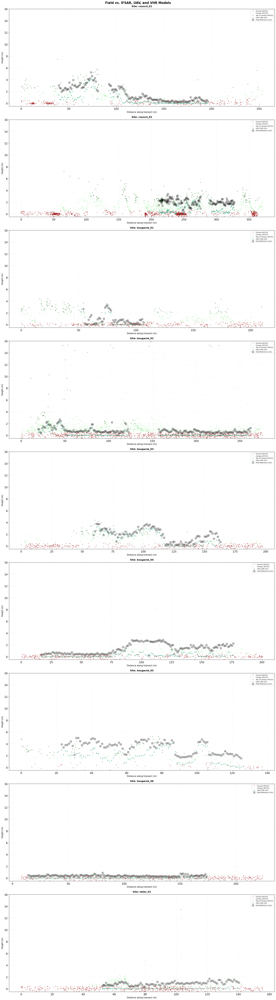

In [82]:
# =============================================================================
# UPDATED USAGE EXAMPLES
# =============================================================================

# # First, diagnose the data
# diagnose_data(all_ref_gdf_extract)

# # Example 1: Basic plot
# fig, axes = create_faceted_transect_plot(
#     gdf=all_ref_gdf_extract,
#     ref_type='field 2m',
#     ncols=2,
#     title='Vegetation Height Transects'
# )
# if fig:
#     plt.show()

# Example 2: With specific models (IFSAR, UAV, VHR)
vhr_cols_selected = [
    #'ht_ifsar', 
    'ht_uavchm200', 
    # 'ht_tolan', 'ht_lang',
    # 'ht_boreal_H30_2020', 'ht_boreal_S1H30_2020',
    #     'ht_20110727_103001000D914900chm_4.3.2.2',
    #    'ht_20120721_103001001AB23900chm_4.3.2.2',
    #    'ht_20160817_103001005B484100chm_4.3.2.2',
    #    'ht_20190820_10300100954DE000chm_4.3.2.2',
    #    'ht_20190820_10300100968FB300chm_4.3.2.2',
    #    'ht_20190820_1030010099BF2F00chm_4.3.2.2',
    #    'ht_20200722_10300100AB1FD100chm_4.3.2.2',
    #    'ht_20170719_104001002F7A2E00chm_4.3.2.2',
    #    'ht_20190822_104001005054F700chm_4.3.2.2',
    #    'ht_20200704_104001005EADB900chm_4.3.2.2',
]

fig, axes = create_faceted_transect_plot(
    gdf=all_ref_gdf_extract,
    ref_type='field 2m',
    vhr_cols=vhr_cols_selected,
    ncols=1,
    title='Field vs. IFSAR, UAV, and VHR Models'
)
if fig:
    plt.show()

Scaling 129 VHR columns by 0.1 (dm to m)

Data summary:
  ATL03 rows: 8215
  Field (field 2m) rows: 1140
  Field sites: ['council_01', 'council_02', 'kougarok_01', 'kougarok_02', 'kougarok_03', 'kougarok_04', 'kougarok_05', 'kougarok_06', 'teller_01']

Will plot 9 sites: ['council_01', 'council_02', 'kougarok_01', 'kougarok_02', 'kougarok_03', 'kougarok_04', 'kougarok_05', 'kougarok_06', 'teller_01']


/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/geopandas/geodataframe.py:1443: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)



Plotting site 1/9: council_01

  Plotting site with 633 ATL03 points and 140 field points
    Plotting 140 field reference points

Plotting site 2/9: council_02

  Plotting site with 2107 ATL03 points and 150 field points
    Plotting 148 field reference points

Plotting site 3/9: kougarok_01

  Plotting site with 761 ATL03 points and 50 field points
    Plotting 50 field reference points

Plotting site 4/9: kougarok_02

  Plotting site with 1796 ATL03 points and 200 field points
    Plotting 200 field reference points

Plotting site 5/9: kougarok_03

  Plotting site with 628 ATL03 points and 100 field points
    Plotting 100 field reference points

Plotting site 6/9: kougarok_04

  Plotting site with 618 ATL03 points and 150 field points
    Plotting 150 field reference points

Plotting site 7/9: kougarok_05

  Plotting site with 254 ATL03 points and 100 field points
    Plotting 100 field reference points

Plotting site 8/9: kougarok_06

  Plotting site with 633 ATL03 points and 150

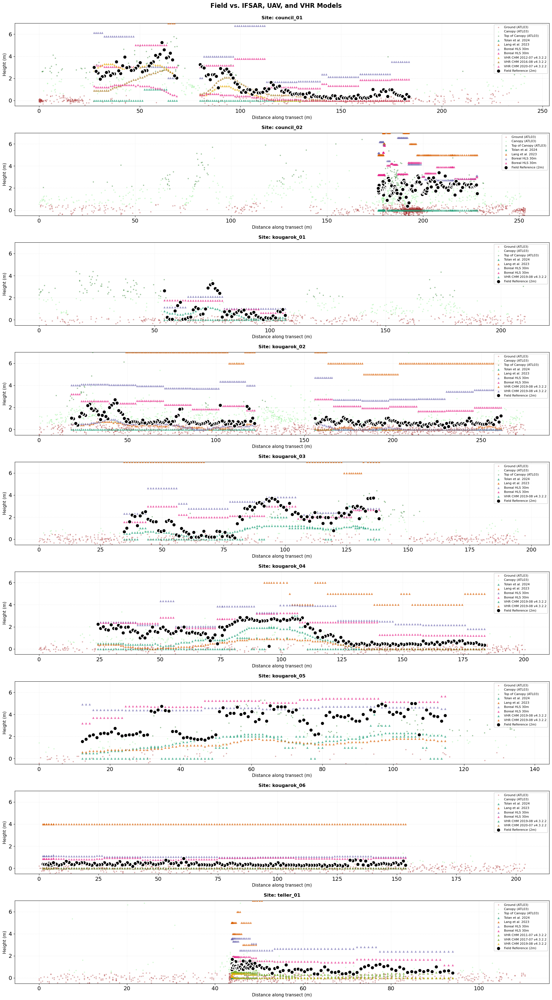

In [21]:
# =============================================================================
# UPDATED USAGE EXAMPLES
# =============================================================================

# # First, diagnose the data
# diagnose_data(all_ref_gdf_extract)

# # Example 1: Basic plot
# fig, axes = create_faceted_transect_plot(
#     gdf=all_ref_gdf_extract,
#     ref_type='field 2m',
#     ncols=2,
#     title='Vegetation Height Transects'
# )
# if fig:
#     plt.show()

# Example 2: With specific models (IFSAR, UAV, VHR)
vhr_cols_selected = [
    #'ht_ifsar', 'ht_uavchm200', 
    'ht_tolan', 'ht_lang',
    'ht_boreal_H30_2020', 'ht_boreal_S1H30_2020',
        'ht_20110727_103001000D914900chm_4.3.2.2',
       'ht_20120721_103001001AB23900chm_4.3.2.2',
       'ht_20160817_103001005B484100chm_4.3.2.2',
       'ht_20190820_10300100954DE000chm_4.3.2.2',
       'ht_20190820_10300100968FB300chm_4.3.2.2',
       'ht_20190820_1030010099BF2F00chm_4.3.2.2',
       'ht_20200722_10300100AB1FD100chm_4.3.2.2',
       'ht_20170719_104001002F7A2E00chm_4.3.2.2',
       'ht_20190822_104001005054F700chm_4.3.2.2',
       'ht_20200704_104001005EADB900chm_4.3.2.2',
]

fig, axes = create_faceted_transect_plot(
    gdf=all_ref_gdf_extract,
    ref_type='field 2m',
    vhr_cols=vhr_cols_selected,
    ncols=1,
    title='Field vs. IFSAR, UAV, and VHR Models'
)
if fig:
    plt.show()

CREATING FACETED TRANSECT PLOT

Will plot 9 sites: ['council_01', 'council_02', 'kougarok_01', 'kougarok_02', 'kougarok_03', 'kougarok_04', 'kougarok_05', 'kougarok_06', 'teller_01']


/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/geopandas/geodataframe.py:1443: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)



Plotting site 1/9: council_01

  Site: council_01
    ATL03 points: 633
    Field points: 140
    Field distance range: 39.5 - 195.9 m
    Field height range: 0.15 - 5.25 m
    ATL03 distance range: 0.0 - 253.6 m
      Model VHR CHM 2012-07 v4.3.2.2: 140 points, range: 0.00 - 3.30 m
      Model VHR CHM 2016-08 v4.3.2.2: 140 points, range: 0.00 - 2.80 m
      Model VHR CHM 2020-07 v4.3.2.2: 140 points, range: 0.00 - 1.40 m
      Model IFSAR CHM: 72 points, range: 0.00 - 1.69 m
      Field Reference: 140 valid points
      First field point: distance=80.6m, height=2.04m
    X-axis range: 0.0 - 253.6 m

Plotting site 2/9: council_02

  Site: council_02
    ATL03 points: 2107
    Field points: 150
    Field distance range: 211.4 - 327.5 m
    Field height range: 0.37 - 3.40 m
    ATL03 distance range: 0.0 - 370.8 m
      Model IFSAR CHM: 87 points, range: 0.00 - 0.74 m
      Field Reference: 148 valid points
      First field point: distance=238.5m, height=2.40m
    X-axis range: 0.0 - 37

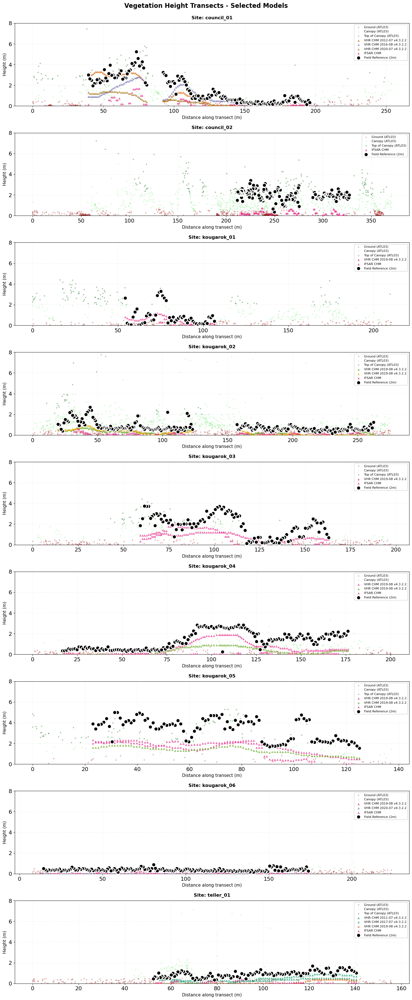

In [55]:
# ===These are good too  ==========================================================================
# USAGE EXAMPLES
# =============================================================================

# # Example 1: Basic faceted plot with auto-detected VHR columns
# fig, axes = create_faceted_transect_plot(
#     gdf=all_ref_gdf_extract,
#     ref_type='field 2m',
#     ncols=1,  # 2 columns of plots
#     title='Vegetation Height Transects - Field Reference vs. Remote Sensing Products'
# )
# plt.show()

# Example 2: Select specific VHR models
vhr_cols_selected = [
        'ht_20110727_103001000D914900chm_4.3.2.2',
       'ht_20120721_103001001AB23900chm_4.3.2.2',
       'ht_20160817_103001005B484100chm_4.3.2.2',
       'ht_20190820_10300100954DE000chm_4.3.2.2',
       'ht_20190820_10300100968FB300chm_4.3.2.2',
       'ht_20190820_1030010099BF2F00chm_4.3.2.2',
       'ht_20200722_10300100AB1FD100chm_4.3.2.2',
       'ht_20170719_104001002F7A2E00chm_4.3.2.2',
       'ht_20190822_104001005054F700chm_4.3.2.2',
       'ht_20200704_104001005EADB900chm_4.3.2.2',
    'ht_ifsar'
    #'ht_lang',
    #'ht_potapov'
]

fig, axes = create_faceted_transect_plot(
    gdf=all_ref_gdf_extract,
    ref_type='field 2m',
    vhr_cols=vhr_cols_selected,
    ncols=1,
    title='Vegetation Height Transects - Selected Models'
)
plt.show()


CREATING FACETED TRANSECT PLOT

Will plot 9 sites: ['council_01', 'council_02', 'kougarok_01', 'kougarok_02', 'kougarok_03', 'kougarok_04', 'kougarok_05', 'kougarok_06', 'teller_01']

Auto-detected 145 VHR model columns:
  - ht_boreal_H30_2020
  - ht_boreal_S1H30_2020
  - ht_tolan
  - ht_lang
  - ht_potapov
  - ht_nasa_cnn_10m
  - ht_20110727_103001000D914900cnn-chm-v1_v1
  - ht_20120721_103001001AB23900cnn-chm-v1_v1
  - ht_20160817_103001005B484100cnn-chm-v1_v1
  - ht_20190820_10300100954DE000cnn-chm-v1_v1
  ... and 135 more


/panfs/ccds02/app/modules/jupyter/ilab/tensorflow-kernel/lib/python3.8/site-packages/geopandas/geodataframe.py:1443: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)



Plotting site 1/9: council_01

  Site: council_01
    ATL03 points: 633
    Field points: 140
    Field distance range: 39.5 - 195.9 m
    Field height range: 0.15 - 5.25 m
    ATL03 distance range: 0.0 - 253.6 m
      Model Boreal HLS 30m: 140 points, range: 1.69 - 6.77 m
      Model Boreal HLS 30m: 140 points, range: 1.09 - 5.03 m
      Model Tolan et al. 2024: 140 points, range: 0.00 - 1.00 m
      Model Lang et al. 2023: 139 points, range: 7.00 - 10.00 m
      Model Potapov et al. 2021: 140 points, range: 0.00 - 0.00 m
      Model NASA VHR CNN 10m: 140 points, range: 0.00 - 1.80 m
      Model 20120721 103001001AB23900cnn-chm-v1 v1: 140 points, range: 0.00 - 1.30 m
      Model 20160817 103001005B484100cnn-chm-v1 v1: 140 points, range: 0.00 - 2.64 m
      Model 20200722 10300100AB1FD100cnn-chm-v1 v1: 136 points, range: 0.00 - 1.73 m
      Model VHR CHM 2011-07 vv1: 140 points, range: 25.50 - 25.50 m
      Model VHR CHM 2016-08 vv1: 140 points, range: 2.51 - 5.51 m
      Model VHR CH

/explore/nobackup/people/pmontesa/.nccstmp/ipykernel_3044960/118145253.py:326: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()



PLOT COMPLETE


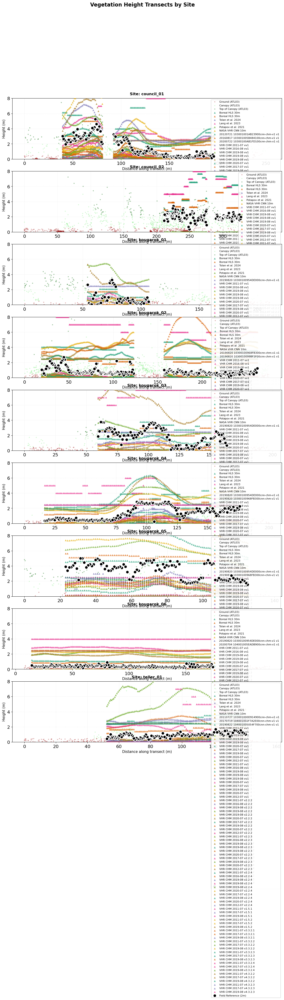

In [57]:

# # Example 3: Specific sites only
# fig, axes = create_faceted_transect_plot(
#     gdf=all_ref_gdf_extract,
#     ref_type='field 2m',
#     sites=['Site1', 'Site2'],  # Replace with actual site names
#     ncols=2
# )
# plt.show()

# Example 4: Single column layout (stacked)
fig, axes = create_faceted_transect_plot(
    gdf=all_ref_gdf_extract,
    ref_type='field 2m',
    ncols=1,
    title='Vegetation Height Transects by Site'
)
plt.show()

# # Example 5: Create summary statistics table
# stats_table = create_summary_statistics_table(
#     gdf=all_ref_gdf_extract,
#     vhr_cols=get_vhr_columns(all_ref_gdf_extract),
#     ref_type='field 2m'
# )
# print("\n=== Model Performance by Site ===")
# print(stats_table.round(3).to_string(index=False))

# # Example 6: Custom configuration
# custom_config = PLOT_CONFIG.copy()
# custom_config['height_ylim'] = (0, 8)
# custom_config['alpha_atl03'] = 0.3

# fig, axes = create_faceted_transect_plot(
#     gdf=all_ref_gdf_extract,
#     ref_type='field 2m',
#     config=custom_config,
#     ncols=2
# )
# plt.show()

# # Example 7: Save figure
# fig, axes = create_faceted_transect_plot(
#     gdf=all_ref_gdf_extract,
#     ref_type='field 2m',
#     ncols=2,
#     title='Vegetation Height Validation Transects'
# )
# fig.savefig('transect_validation_by_site.png', dpi=300, bbox_inches='tight')
# print("Figure saved!")